In [1]:
import os
import glob
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
from tensorflow.keras.layers import *
from tensorflow import keras
from tensorflow.keras.optimizers import *
from tensorflow.keras import layers

In [3]:
import warnings

warnings.simplefilter(action = "ignore", category = RuntimeWarning)

In [4]:
where_to_save = r"G:\My Drive\2021fall\NRE5545\modules\project\data\4. predictions"

In [5]:
model_files = glob.glob(r"G:\My Drive\2021fall\NRE5545\modules\project\code\unetv3_test4_2021Dec03202540.h5")
model_files = model_files[-1:]

In [6]:
model_files

['G:\\My Drive\\2021fall\\NRE5545\\modules\\project\\code\\unetv3_test4_2021Dec03202540.h5']

In [7]:
models = [keras.models.load_model(model_file) for model_file in model_files]

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [8]:
train = pd.read_csv(r"G:\My Drive\2021fall\NRE5545\modules\project\data\3. processed_images\train.csv")
validation = pd.read_csv(r"G:\My Drive\2021fall\NRE5545\modules\project\data\3. processed_images\validation.csv")

train_x = np.array([np.load(f) for f in train['x'].tolist()[:]])
train_y = np.array([np.load(f) for f in train['y'].tolist()[:]])
val_x = np.array([np.load(f) for f in validation['x'].tolist()[:]])
val_y = np.array([np.load(f) for f in validation['y'].tolist()[:]])

In [9]:
import cv2
import numpy as np
import scipy
def sharpening(temp):
    kernel = np.array([[0, -1, 0],
                       [-1, 5,-1],
                       [0, -1, 0]])
    image_sharp = cv2.filter2D(src=temp, ddepth=-1, kernel=kernel)
    return image_sharp

def edge(temp):
    kernel = np.array([[-1, -2, -1],
                       [-2, 12, -2],
                       [-1, -2, -1]])
    image_sharp = cv2.filter2D(src=temp, ddepth=-1, kernel=kernel)
    return image_sharp

def pca_transform(MB_img):
    img_shape = c,r,n_bands = MB_img.shape
    MB_matrix = np.zeros((c*r,n_bands))
    for i in range(n_bands):
        MB_array = MB_img[:,:,i].flatten()  # covert 2d to 1d array 
        MB_arrayStd = (MB_array - MB_array.mean())/MB_array.std()  
        MB_matrix[:,i] = MB_arrayStd

    cov = np.cov(MB_matrix.transpose())

    # Eigen Values
    EigVal,EigVec = np.linalg.eig(cov)

    order = EigVal.argsort()[::-1]
    EigVal = EigVal[order]
    EigVec = EigVec[:,order]

    #Projecting data on Eigen vector directions resulting to Principal Components 
    PC = np.matmul(MB_matrix,EigVec)   #cross product

    # Rearranging 1-d arrays to 2-d arrays of image size

    PC_2d = np.zeros((img_shape[0],img_shape[1],n_bands))
    for i in range(n_bands):
        PC_2d[:,:,i] = PC[:,i].reshape(-1,img_shape[1])

    # normalizing between 0 to 255
    PC_2d_Norm = np.zeros((img_shape[0],img_shape[1],n_bands))
    for i in range(n_bands):
        PC_2d_Norm[:,:,i] = cv2.normalize(PC_2d[:,:,i],
                        np.zeros(img_shape),0,255 ,cv2.NORM_MINMAX)
    return PC_2d_Norm

def moving_average(temp, window = 3):
    temp  = scipy.ndimage.uniform_filter(temp, size=window, mode='constant')
    return temp

def normalize(temp):
    for i in range(temp.shape[-1]):
        temp_norm = temp[:,:,i]
        temp_norm = temp_norm.astype(np.float32) - np.mean(temp_norm)
        
        temptemp = max(temp_norm.min(), temp_norm.max(), key=abs)
        temp_norm= temp_norm.astype(np.float32)/temptemp
        temp[:,:,i] = temp_norm
    return np.array(temp)

# def process_img(temp):
# #     temp1 = np.expand_dims(cv2.cvtColor(sharpening(temp)[:,:,3:6], cv2.COLOR_BGR2GRAY), axis = -1)
#     temp1 = sharpening(temp)[:,:,:]
# #     print(temp1.shape)
#     temp2 = np.expand_dims(cv2.cvtColor(edge(temp)[:,:,2:5], cv2.COLOR_BGR2GRAY), axis = -1)
#     temp3 = pca_transform(temp)[:,:,:4]
#     temp4 = moving_average(temp)[:,:,:3]
#     temp = np.concatenate([temp1,temp2,temp3,temp4],axis = -1)
#     return normalize(temp)

# def process_img(temp):
# #     temp1 = np.expand_dims(cv2.cvtColor(sharpening(temp)[:,:,3:6], cv2.COLOR_BGR2GRAY), axis = -1)
#     temp1 = sharpening(temp)[:,:,:]
# #     print(temp1.shape)
#     temp2 = np.expand_dims(cv2.cvtColor(edge(temp)[:,:,2:5], cv2.COLOR_BGR2GRAY), axis = -1)
#     temp3 = pca_transform(temp)[:,:,:4]
#     temp4 = moving_average(temp)[:,:,:3]
#     temp = np.concatenate([temp[:,:,2:5],temp1,temp2,temp3,temp4],axis = -1)
#     return normalize(temp)
    
def process_img(temp):
#     temp1 = np.expand_dims(cv2.cvtColor(sharpening(temp)[:,:,3:6], cv2.COLOR_BGR2GRAY), axis = -1)
    temp1 = sharpening(temp)[:,:,:]
#     print(temp1.shape)
    temp2 = np.expand_dims(cv2.cvtColor(edge(temp)[:,:,2:5], cv2.COLOR_BGR2GRAY), axis = -1)
    temp3 = pca_transform(temp)[:,:,:4]
    temp4 = moving_average(temp)[:,:,:3]
    temp = np.concatenate([temp[:,:,:],temp1,temp2,temp3,temp4],axis = -1)
    return normalize(temp)
    

In [10]:
train_x = np.array([process_img(each) for each in train_x])
val_x = np.array([process_img(each) for each in val_x])

In [11]:
print(train_x.shape, train_y.shape, val_x.shape, val_y.shape)

(300, 320, 320, 20) (300, 320, 320, 2) (123, 320, 320, 20) (123, 320, 320, 2)


In [12]:
for i, sample in enumerate(val_x):
    sample = np.expand_dims(sample,0)
    predictions = np.array([model.predict(sample) for model in models])
    
    temp = validation['y'].tolist()[i]
    filename = os.path.basename(temp)
    temp = os.path.dirname(temp) # to get folder name
    folder = os.path.basename(temp)
    if not os.path.exists(os.path.join(where_to_save, folder)):
        os.mkdir(os.path.join(where_to_save, folder))
    
    for j,prediction in enumerate(predictions):
        new_filename = os.path.join(where_to_save, folder, f"{os.path.basename(model_files[j]).replace('.h5','')}_{filename}")
        if not os.path.exists(new_filename):
            np.save(new_filename,prediction)

In [13]:
losses = [model.evaluate(val_x, val_y) for model in models]
losses

123/123 [==============================] - 4s 29ms/sample - loss: 0.2444 - acc: 0.9039


[[0.2444346912992679, 0.90389234]]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


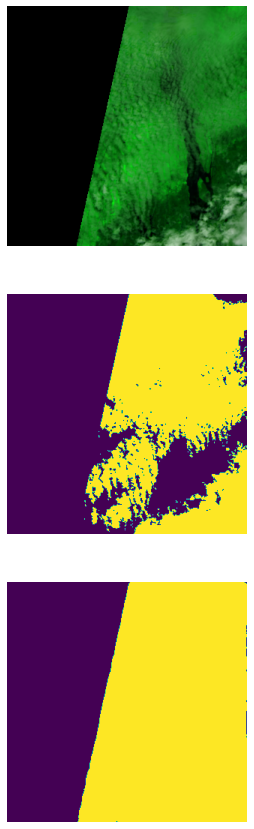

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


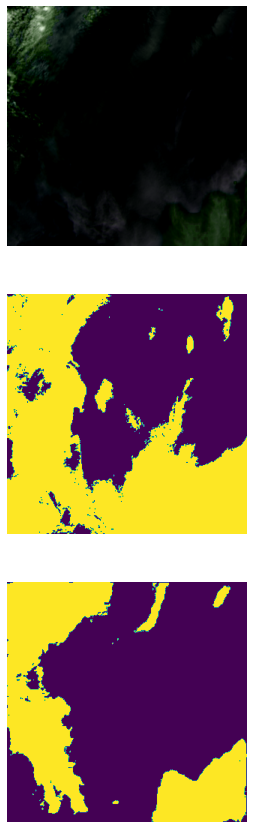

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


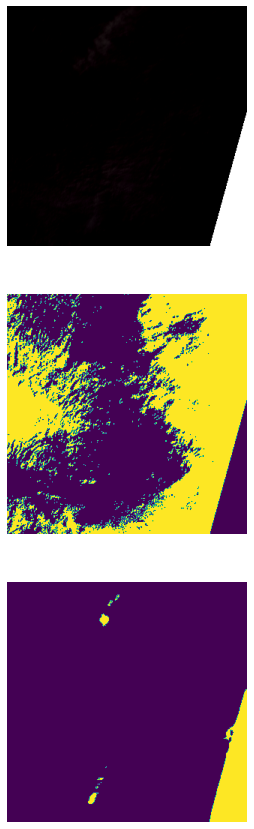

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


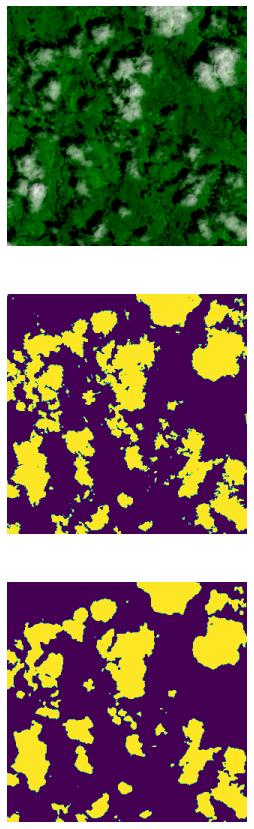

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


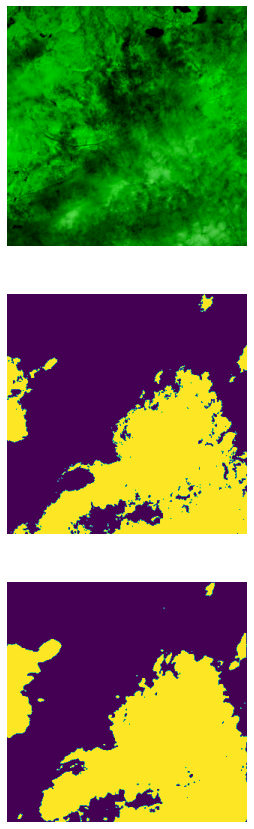

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


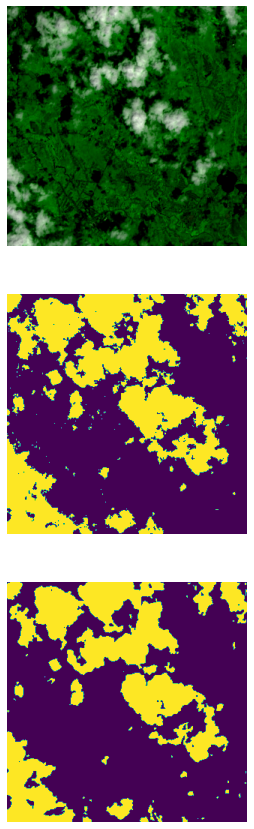

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


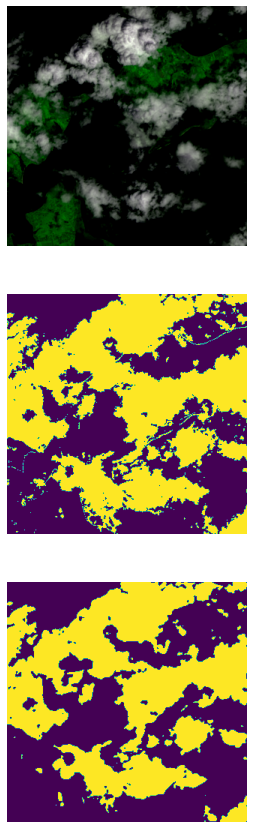

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


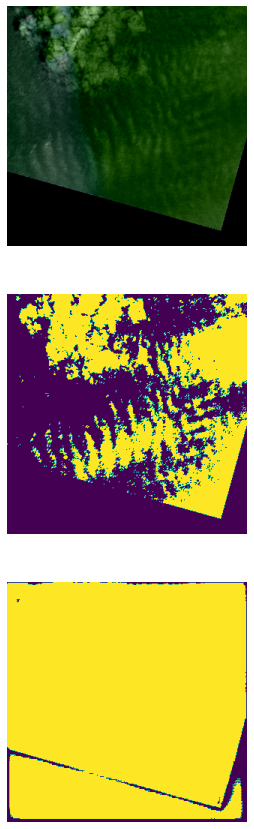

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


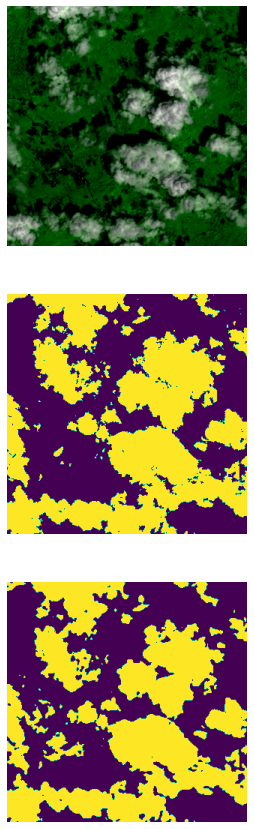

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


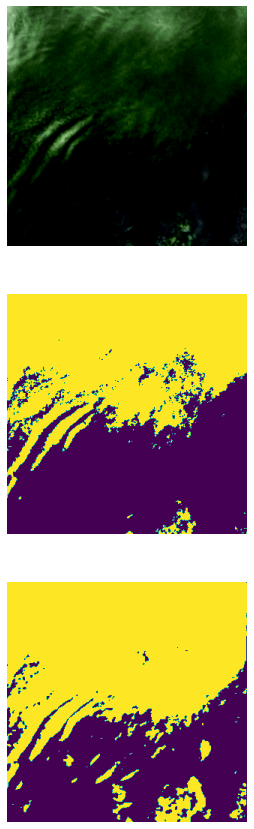

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


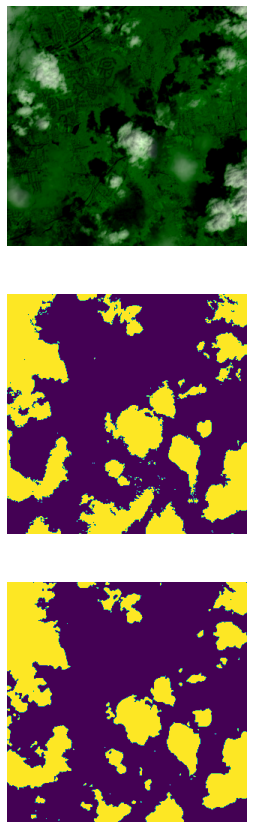

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


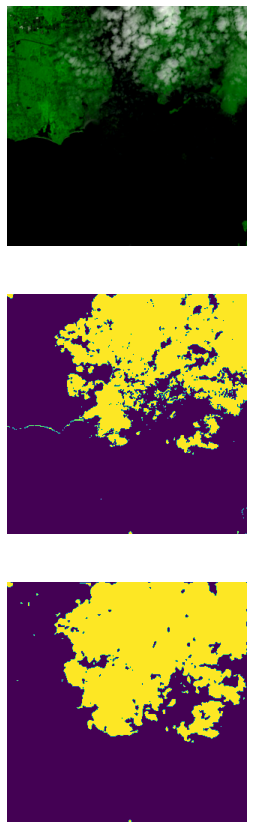

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


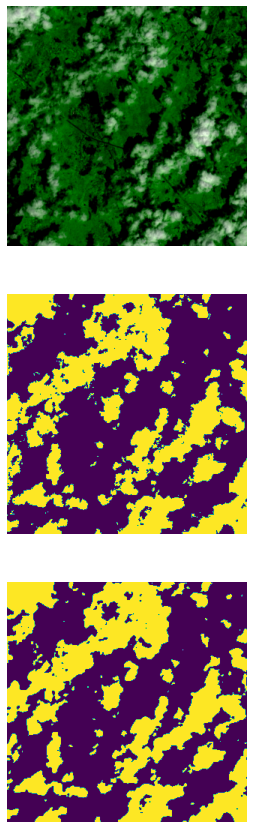

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


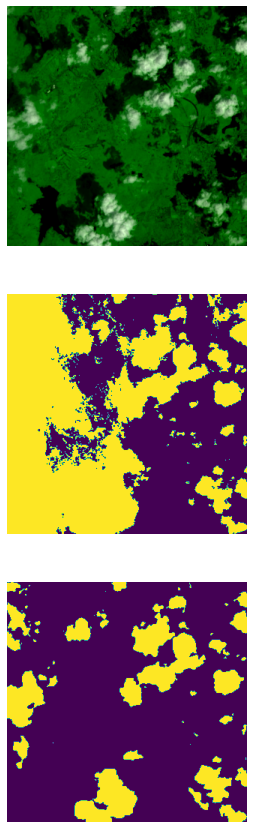

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


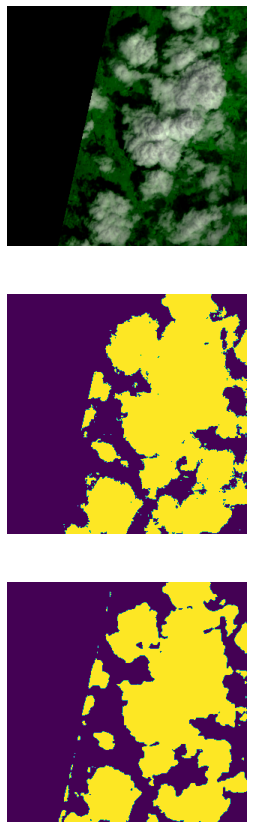

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


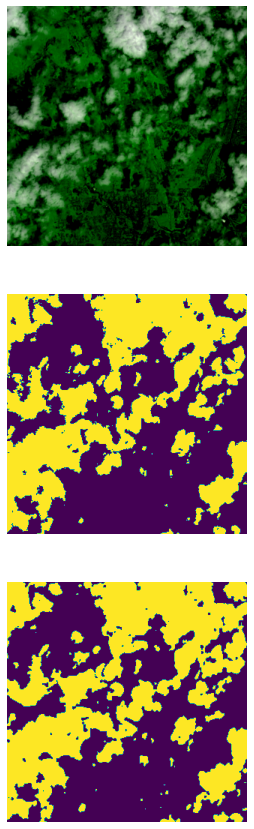

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


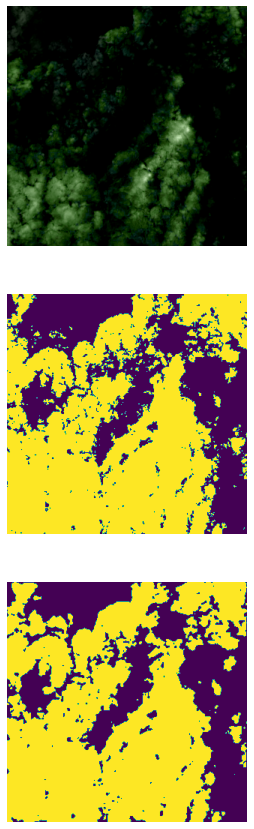

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


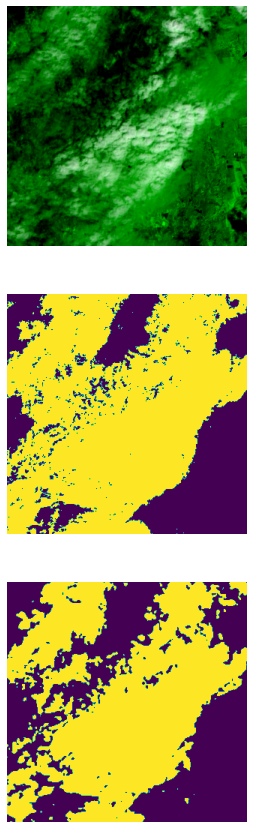

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


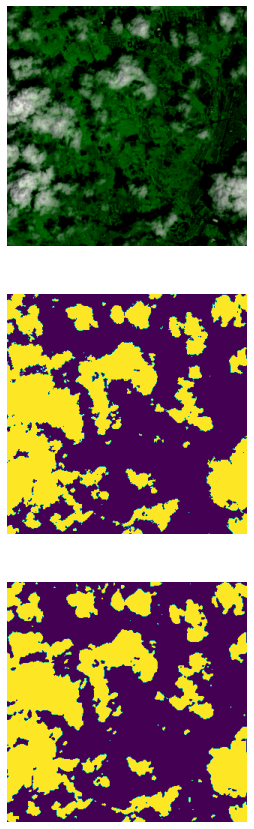

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


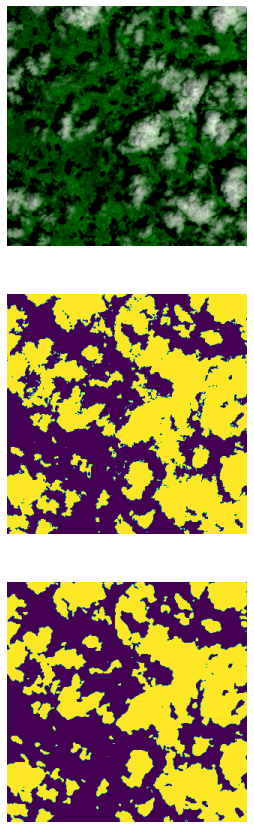

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


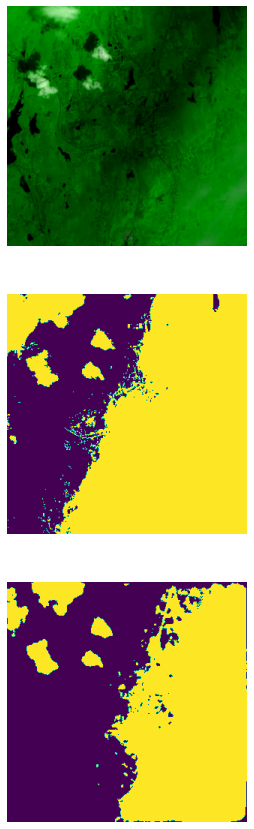

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


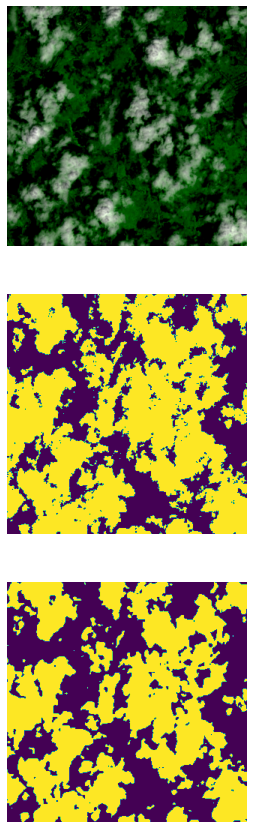

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


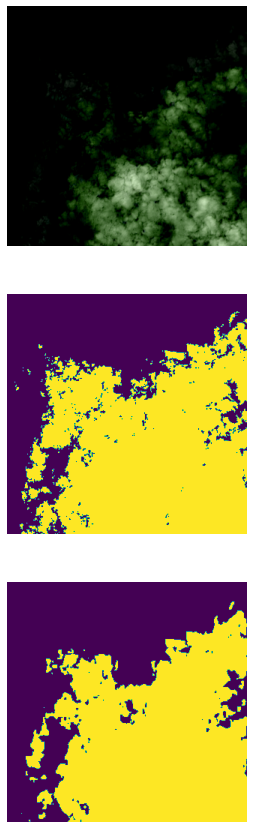

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


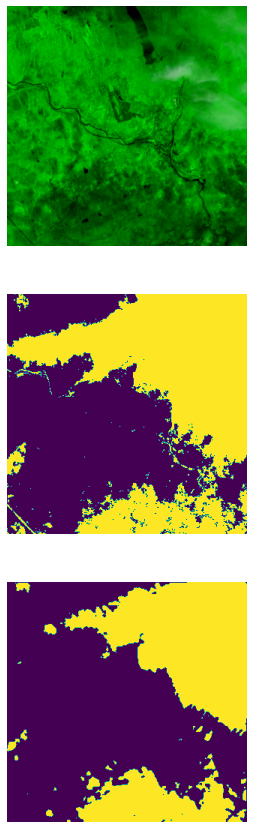

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


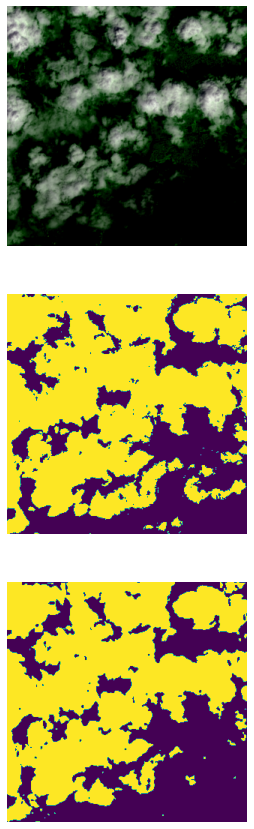

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


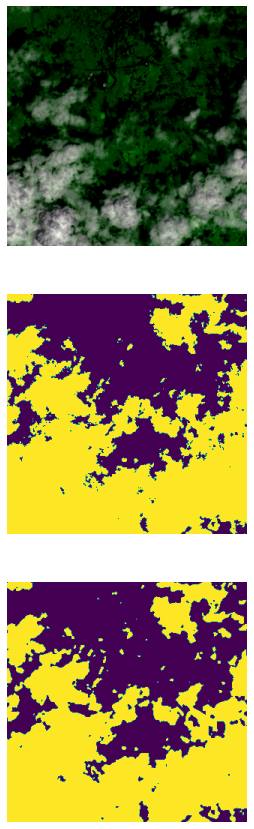

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


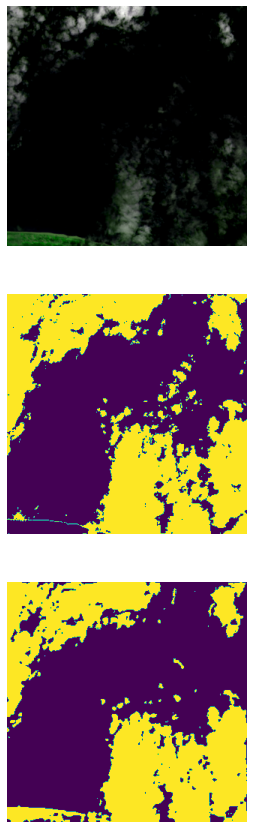

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


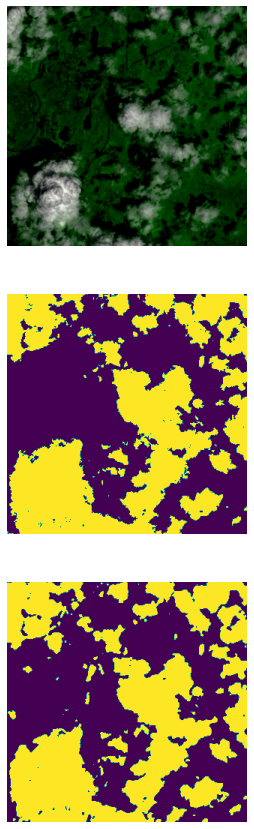

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


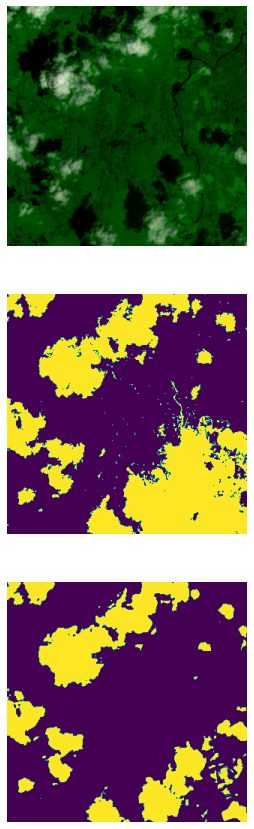

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


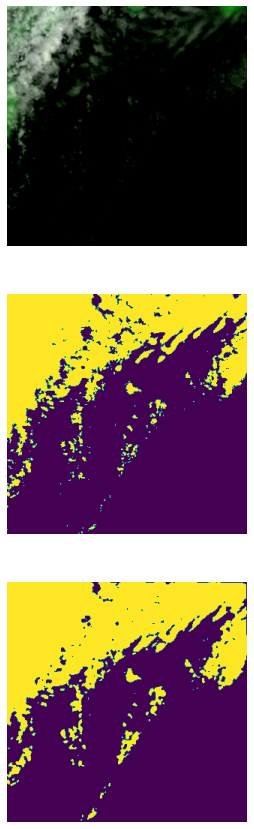

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


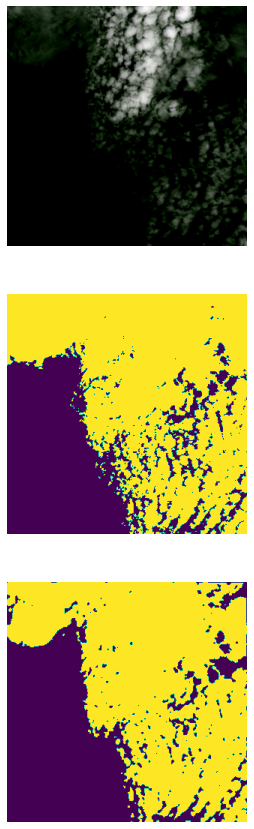

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


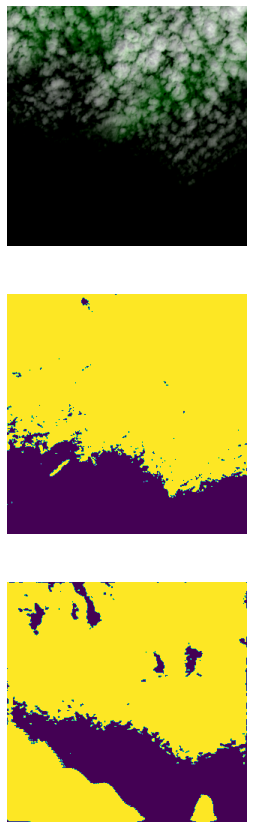

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


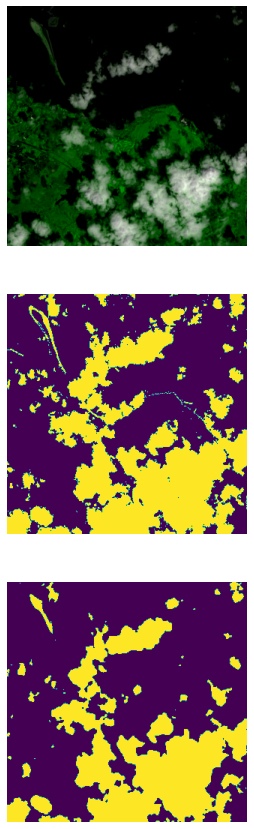

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


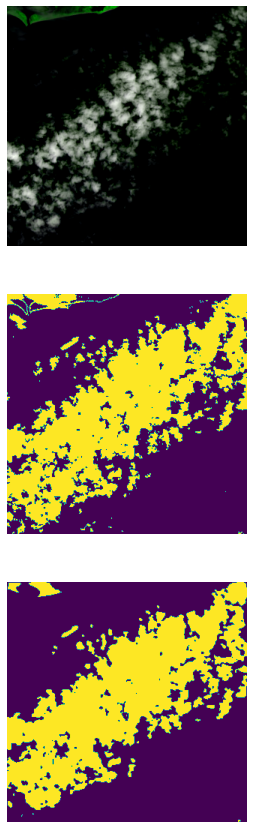

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


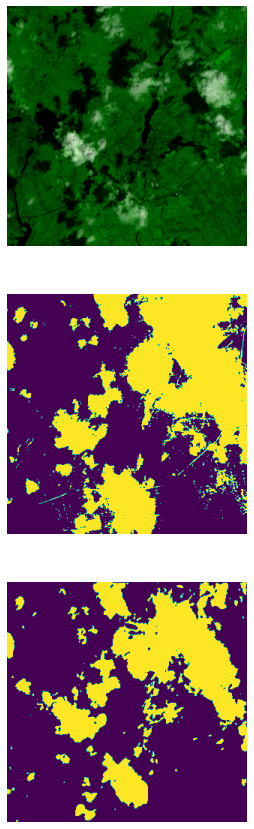

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


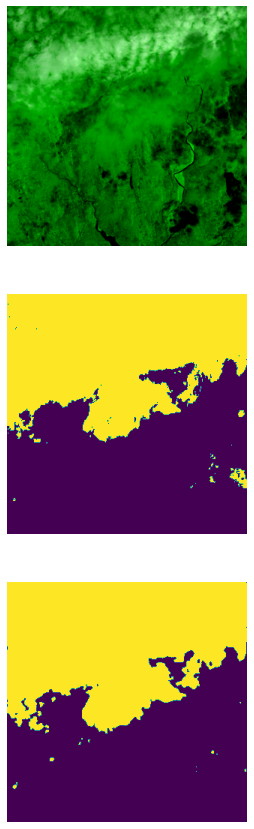

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


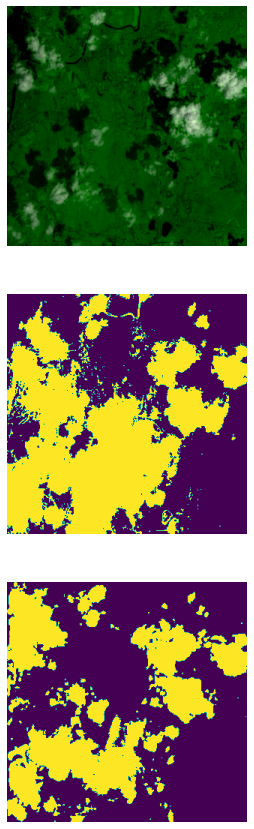

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


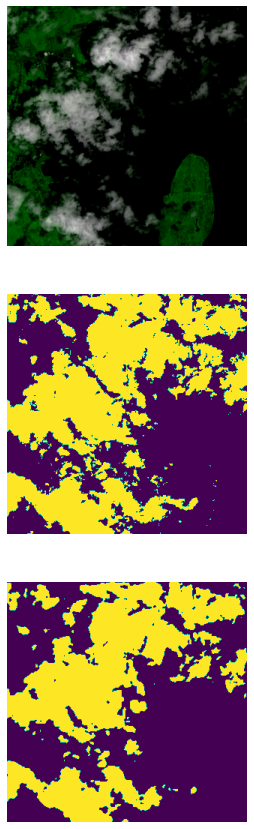

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


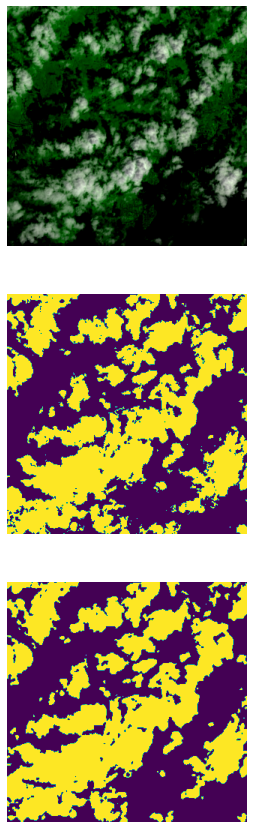

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


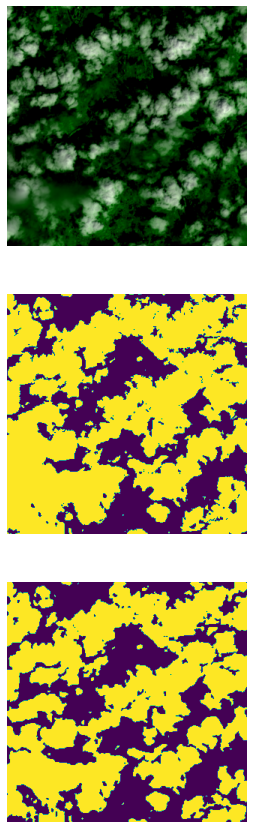

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


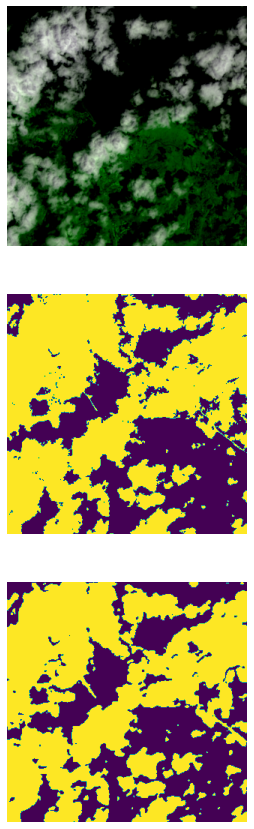

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


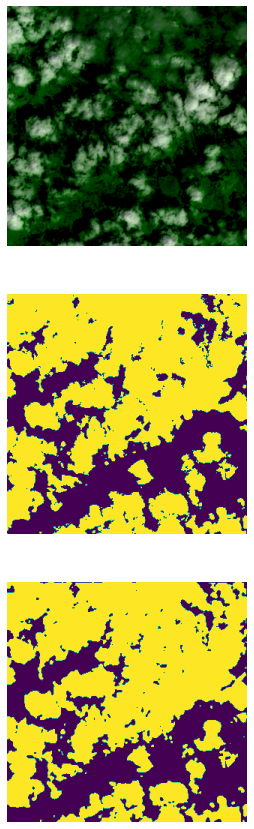

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


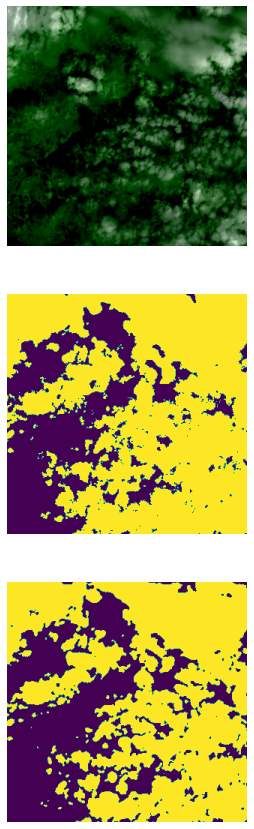

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


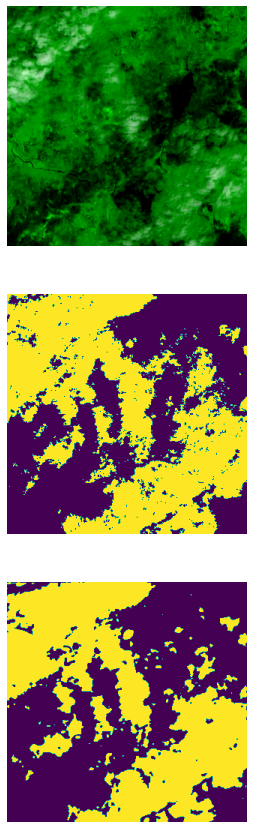

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


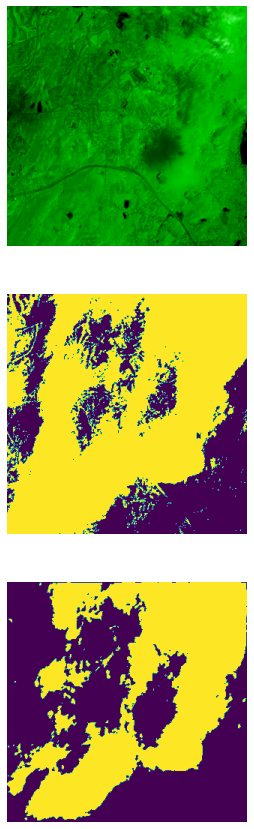

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


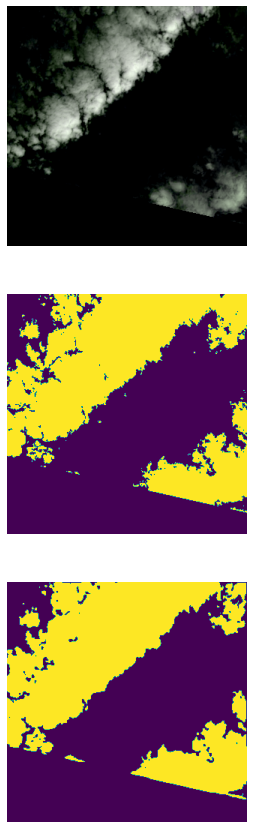

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


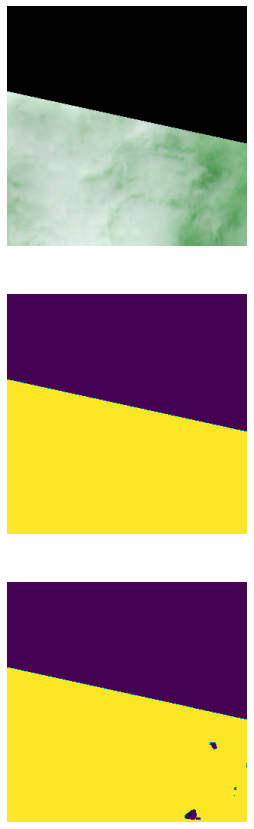

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


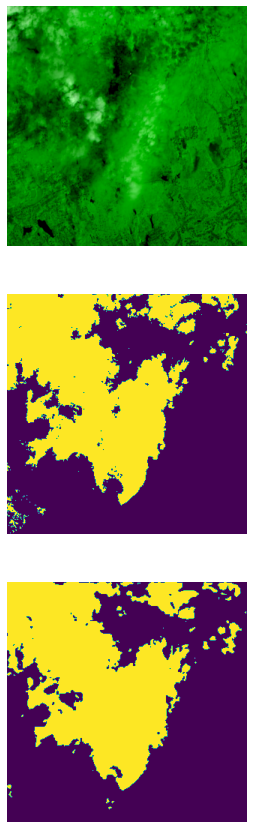

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


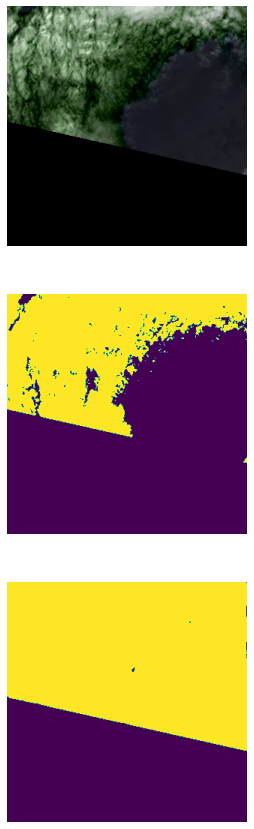

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


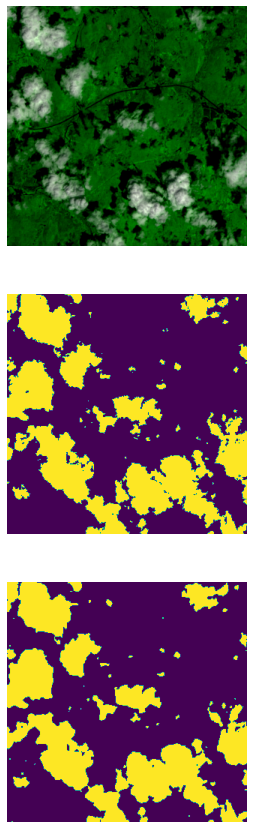

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


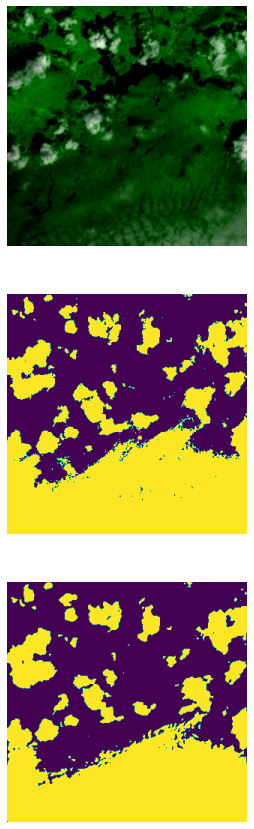

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


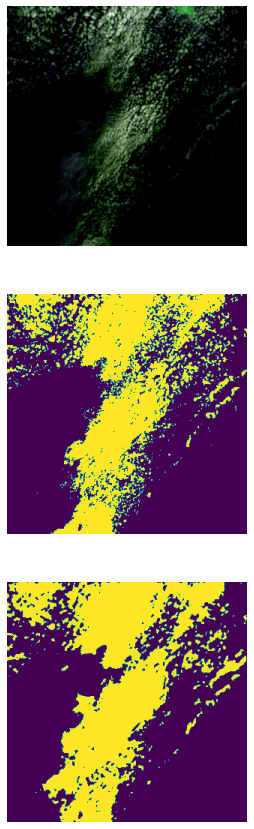

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


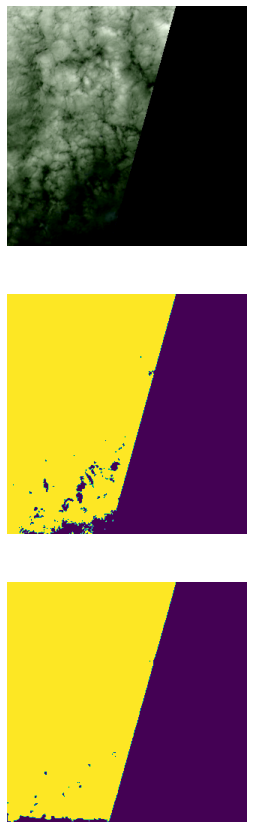

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


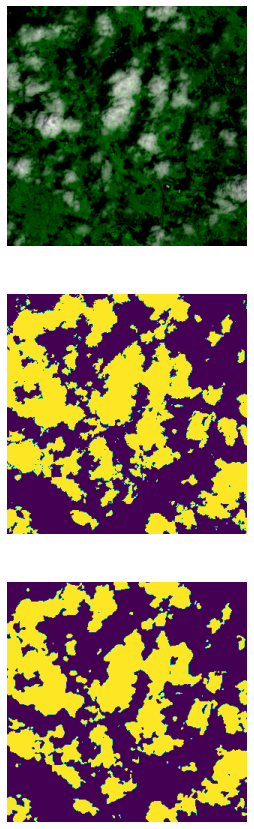

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


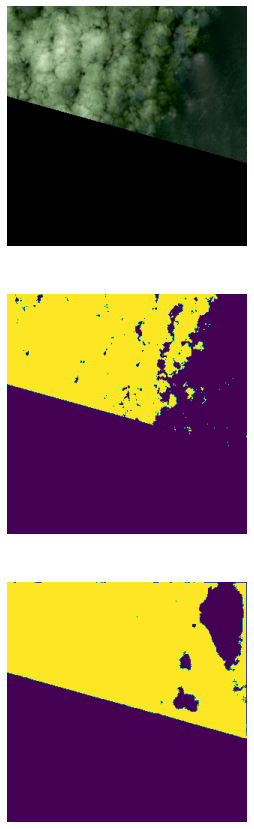

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


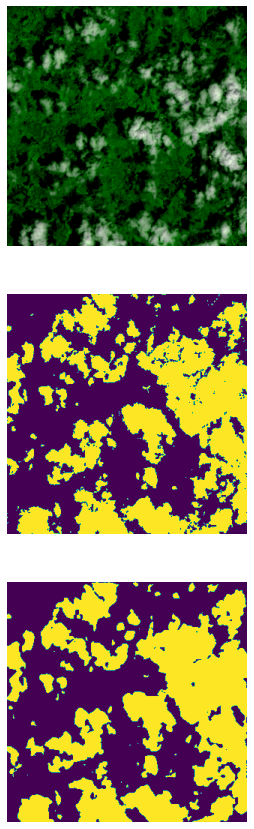

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


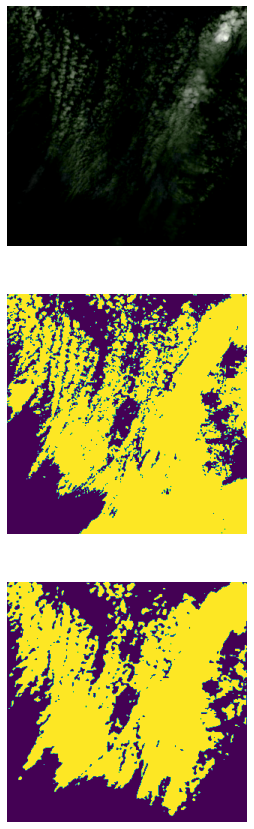

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


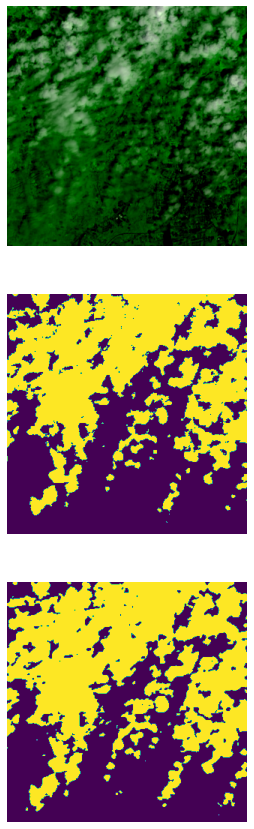

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


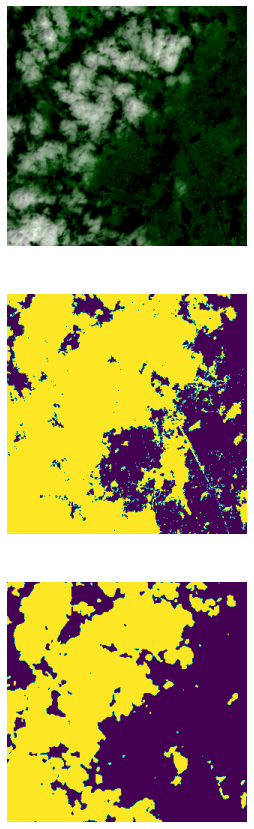

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


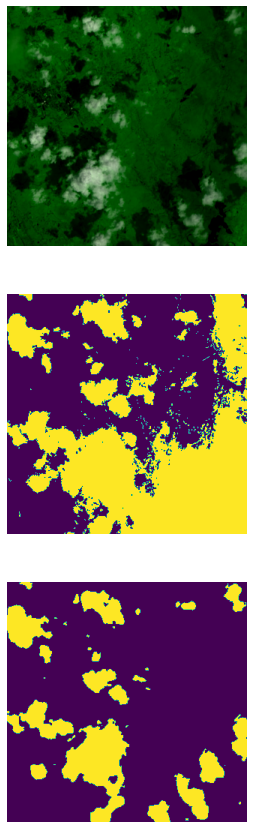

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


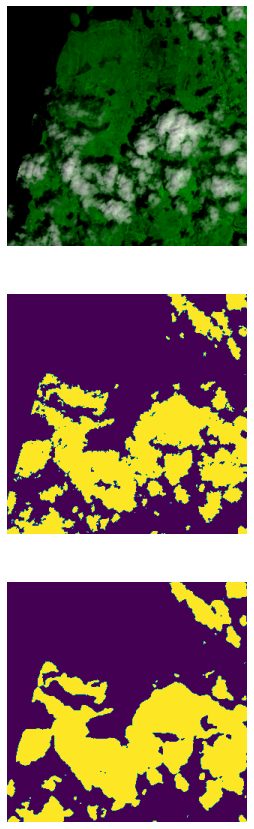

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


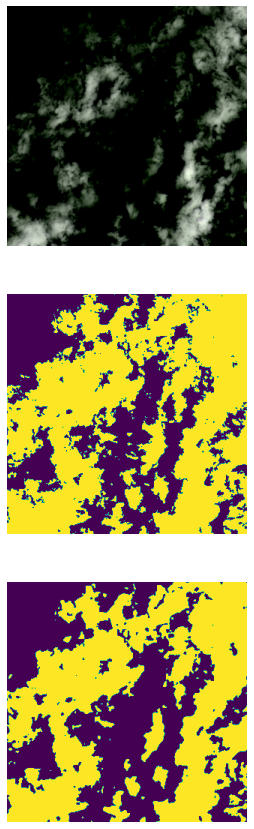

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


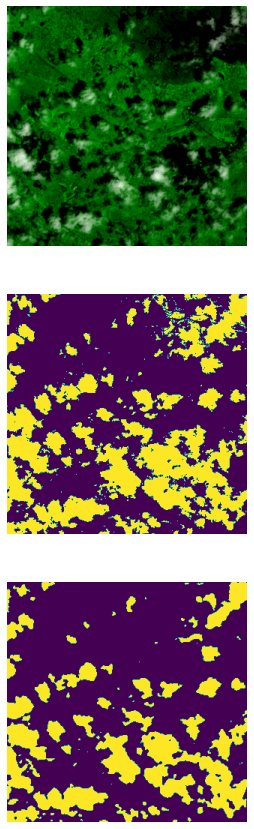

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


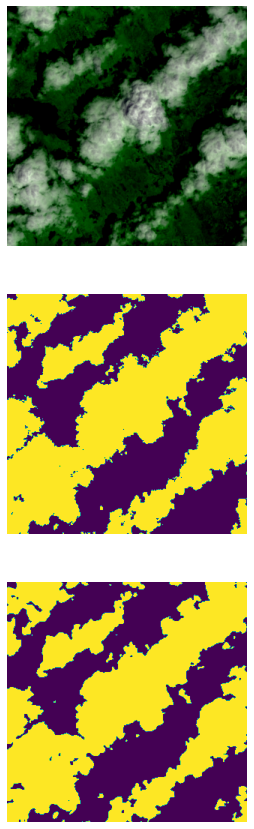

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


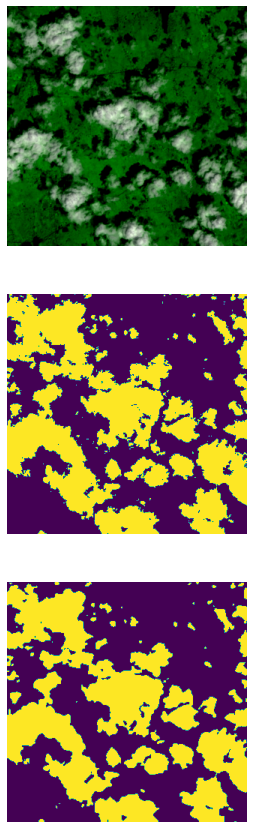

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


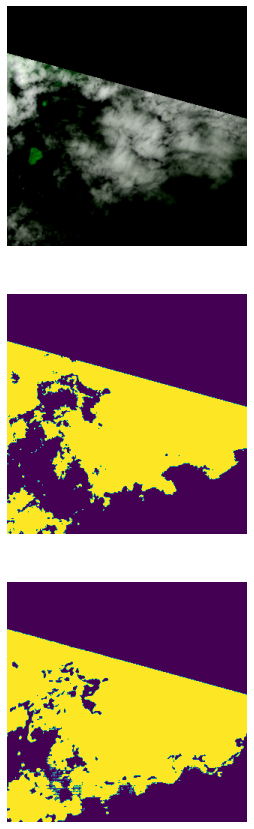

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


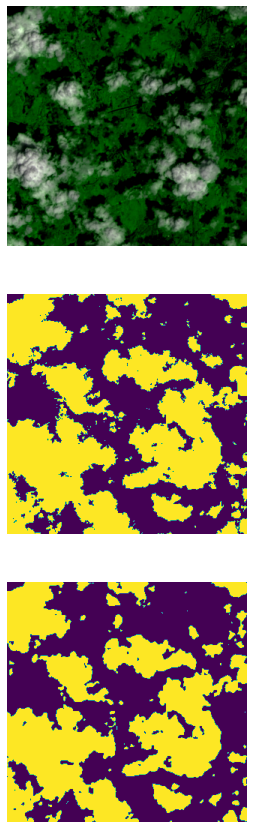

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


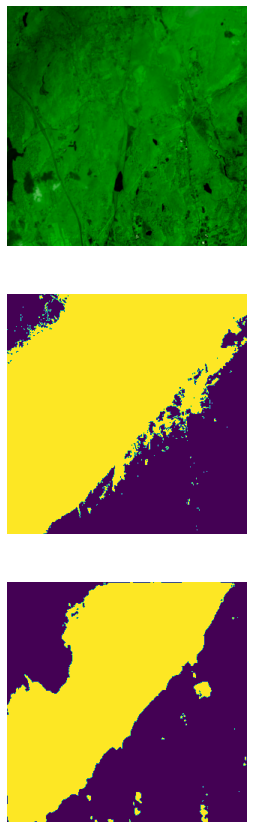

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


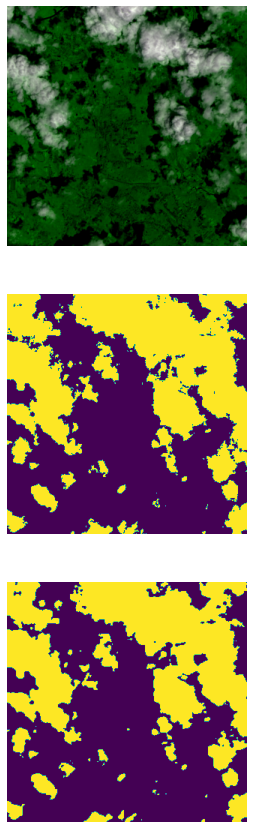

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


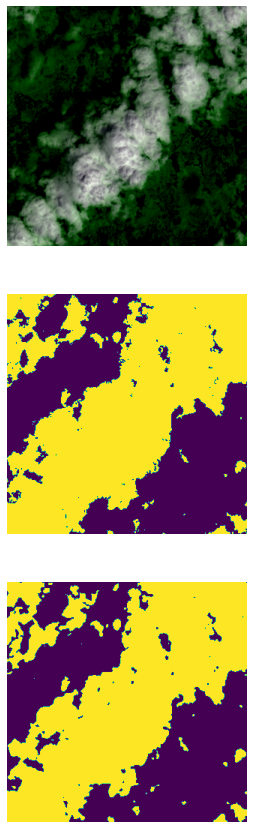

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


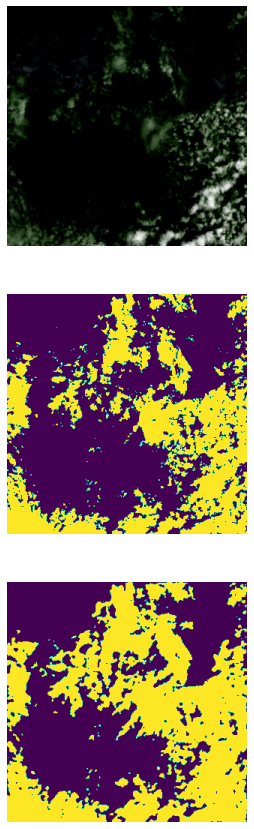

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


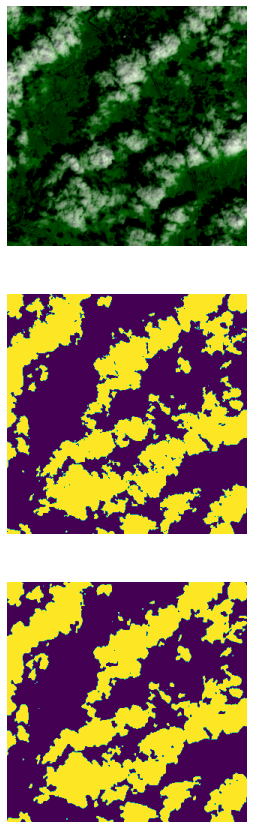

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


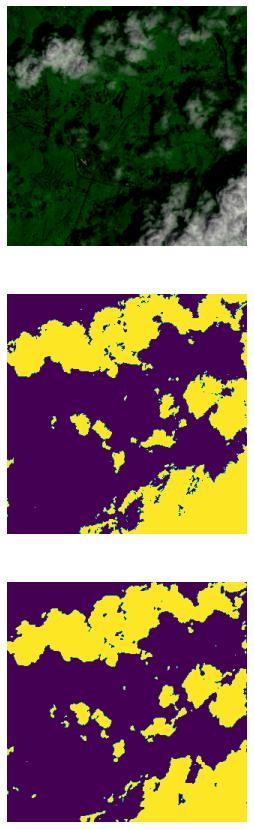

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


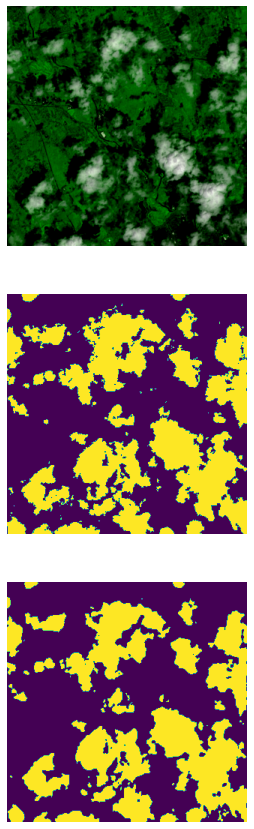

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


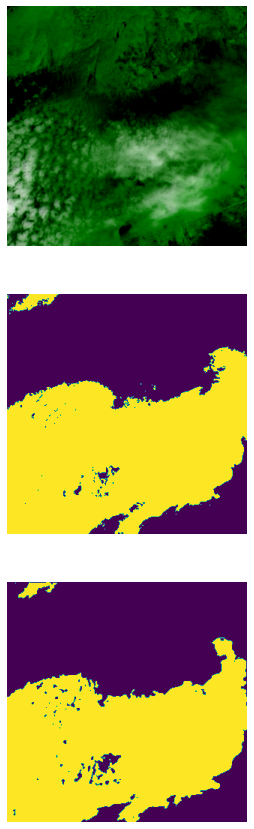

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


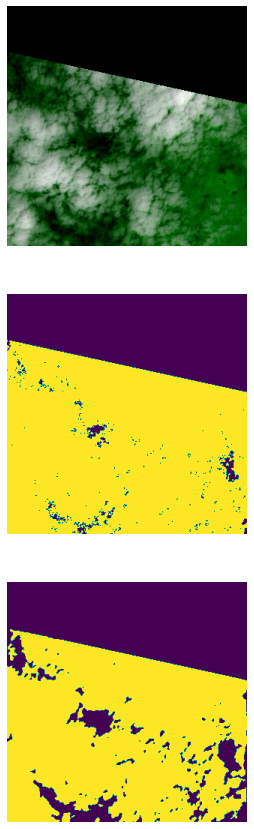

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


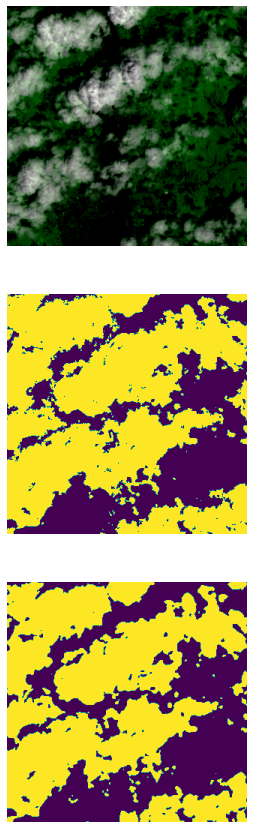

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


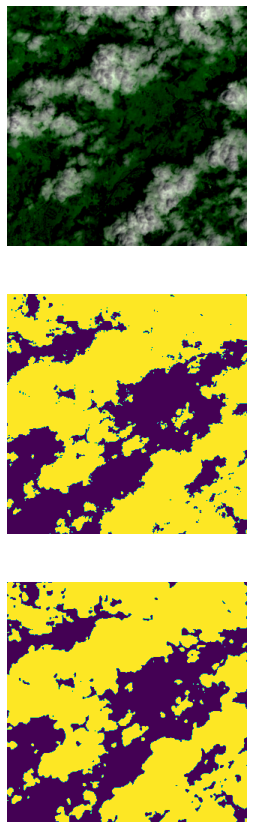

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


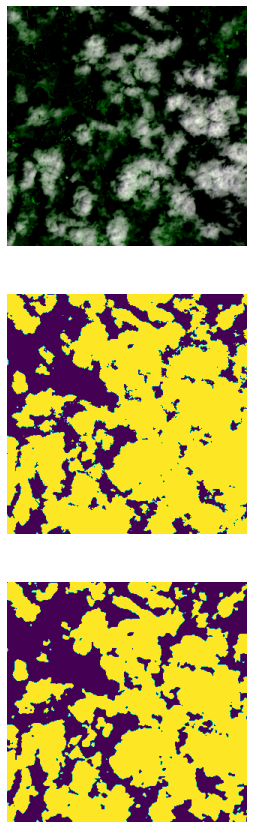

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


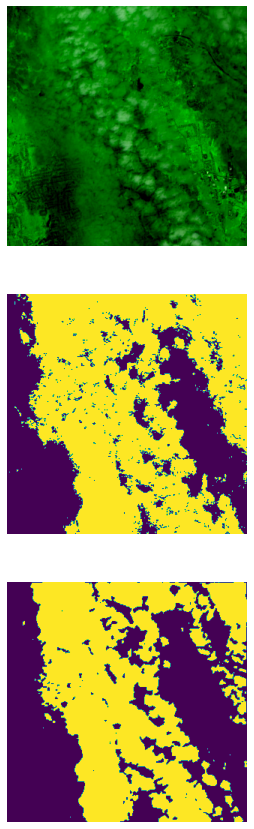

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


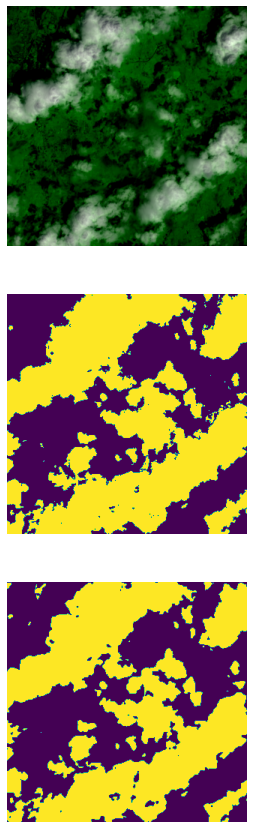

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


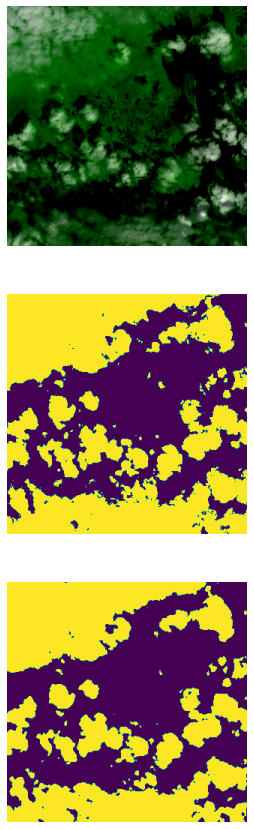

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


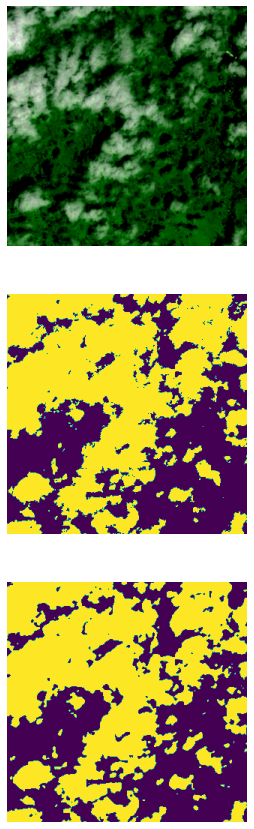

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


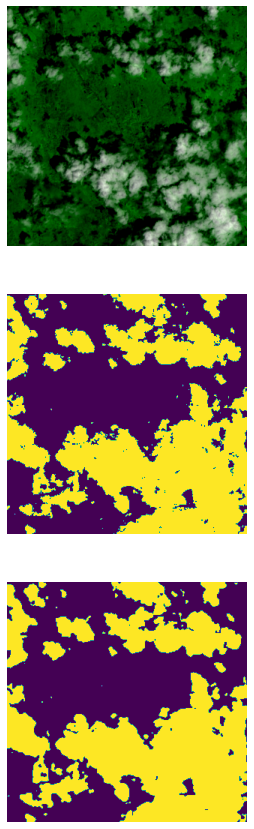

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


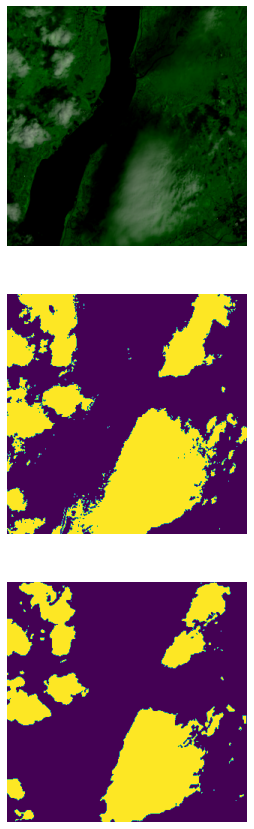

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


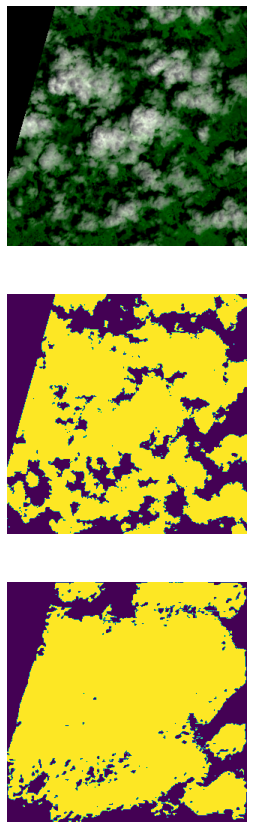

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


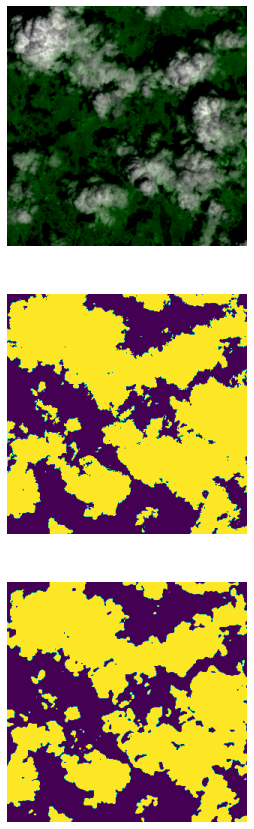

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


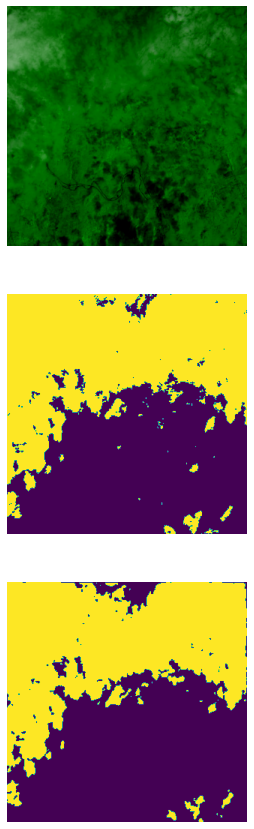

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


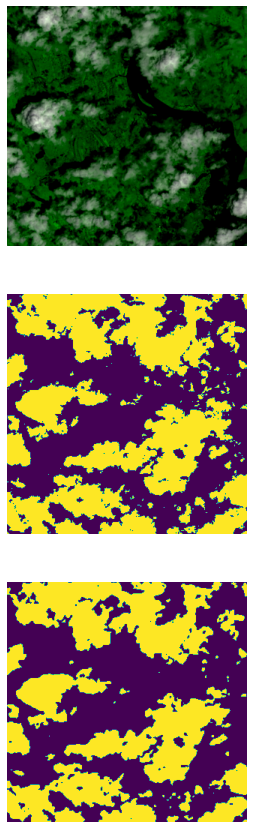

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


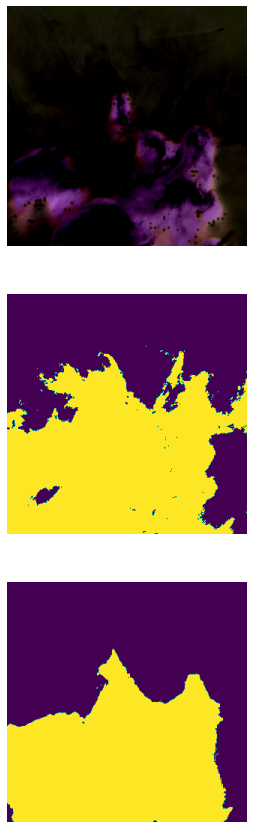

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


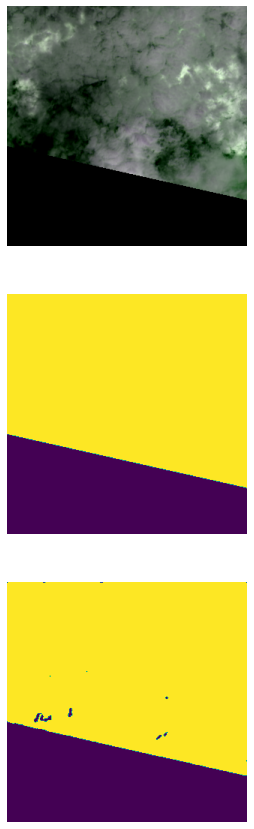

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


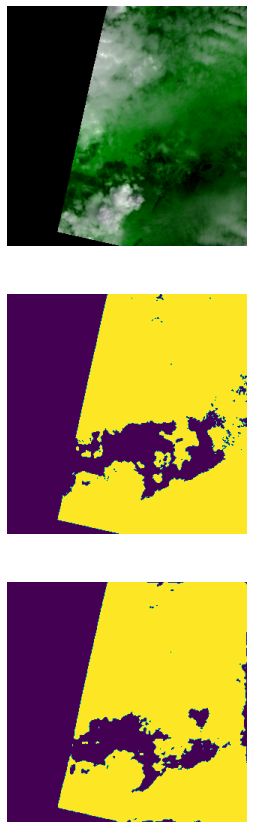

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


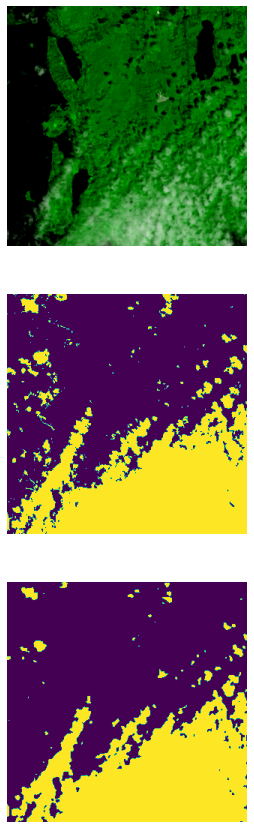

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


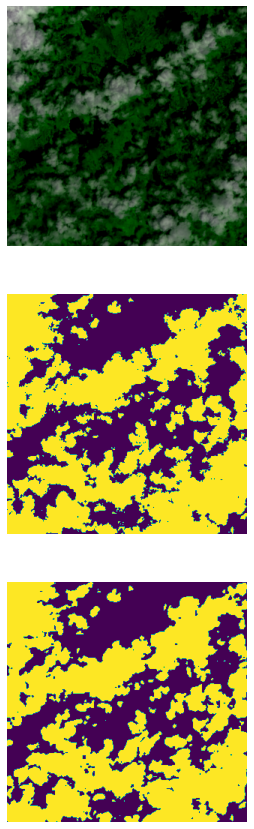

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


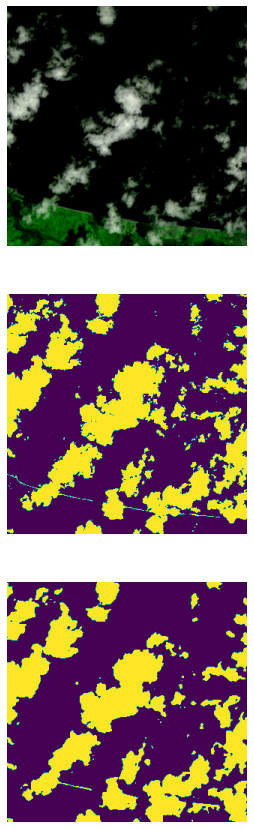

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


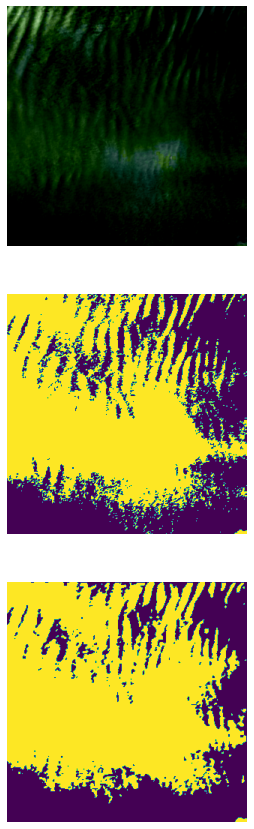

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


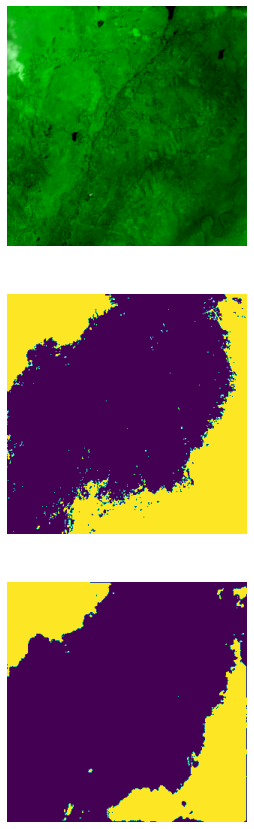

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


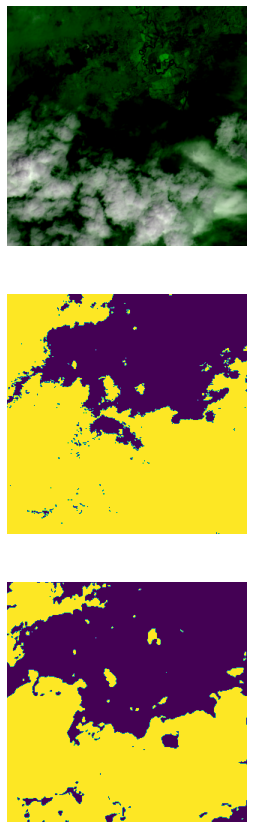

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


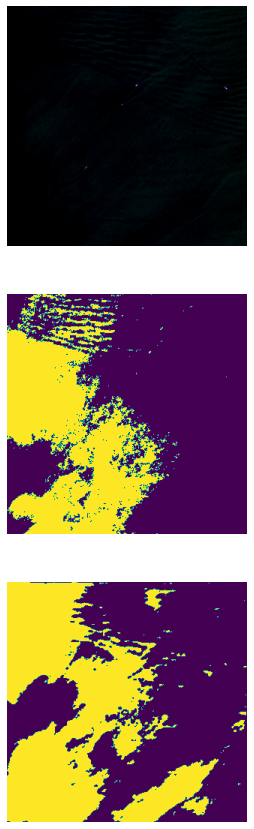

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


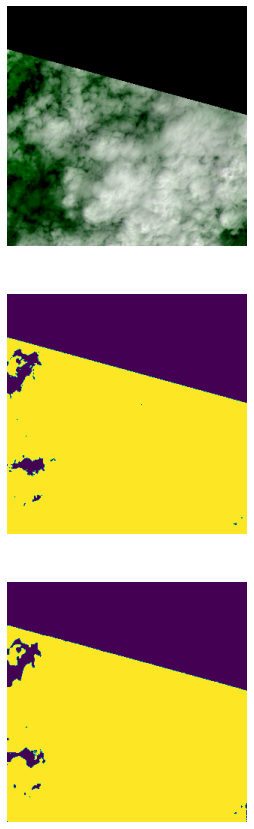

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


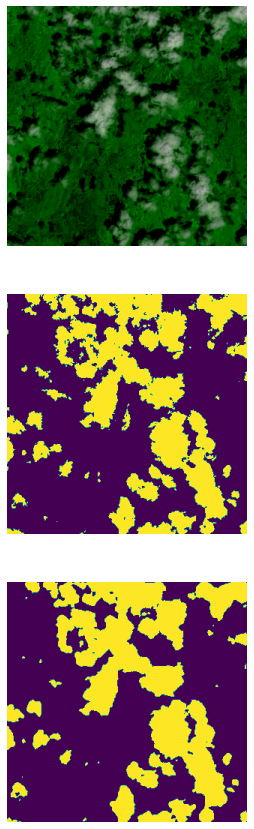

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


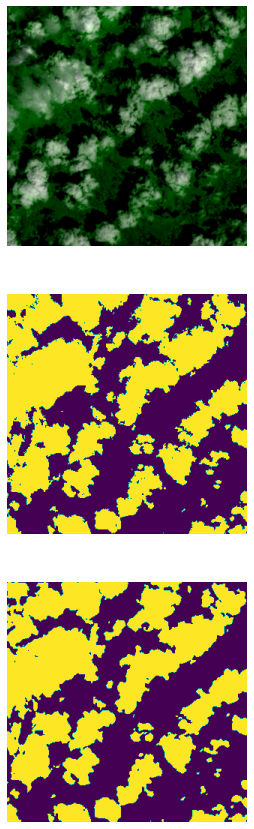

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


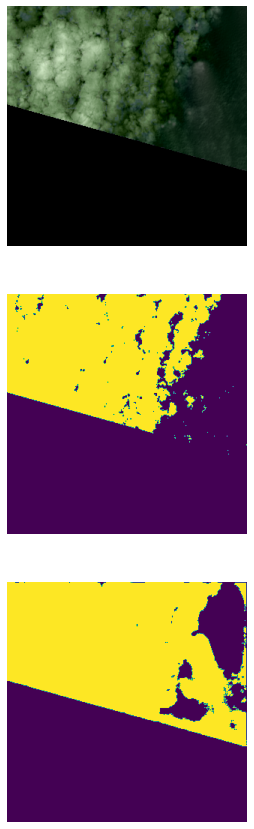

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


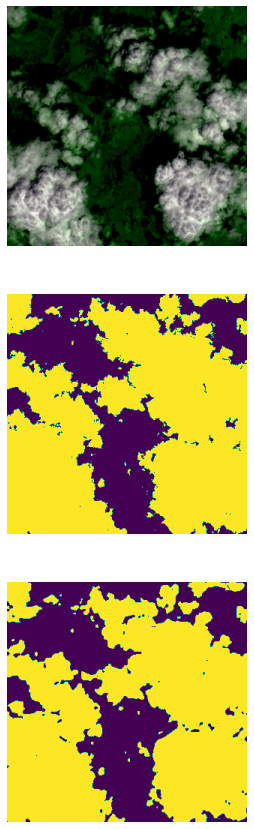

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


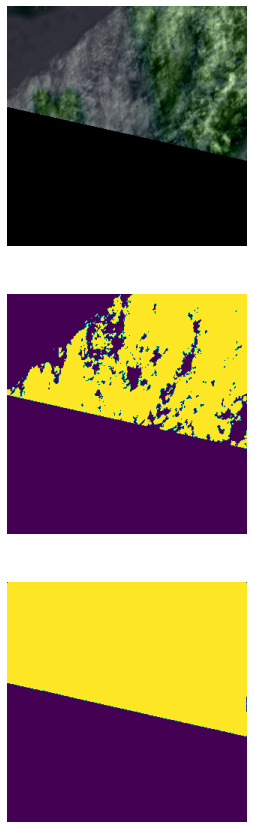

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


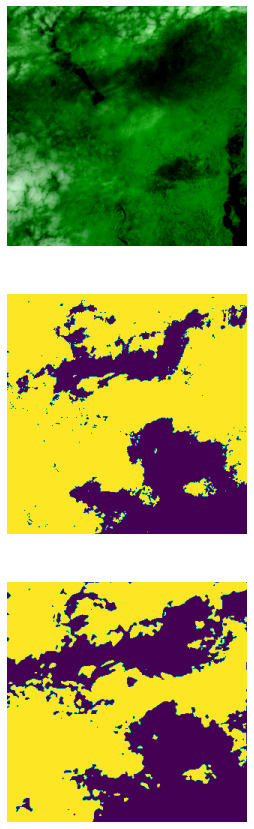

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


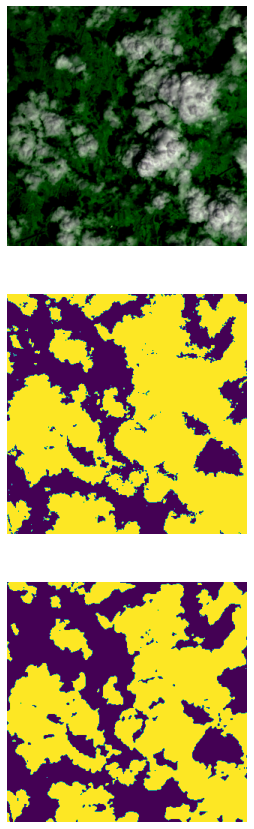

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


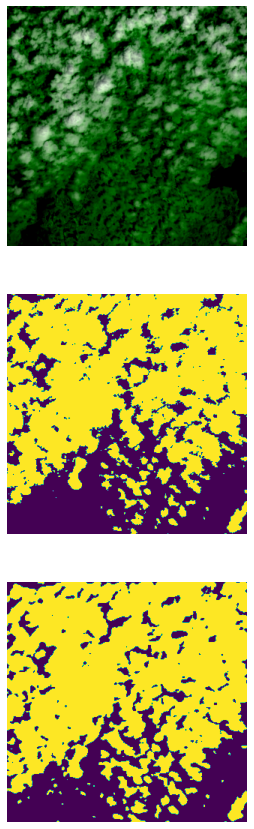

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


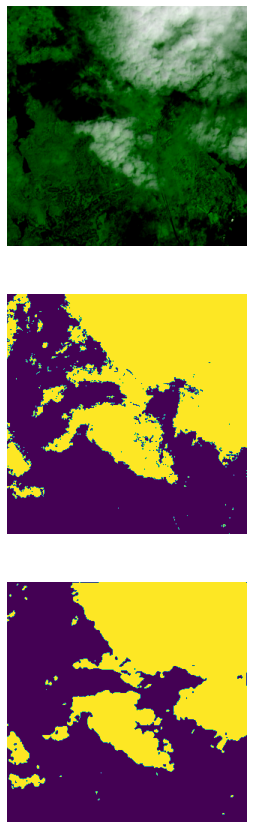

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


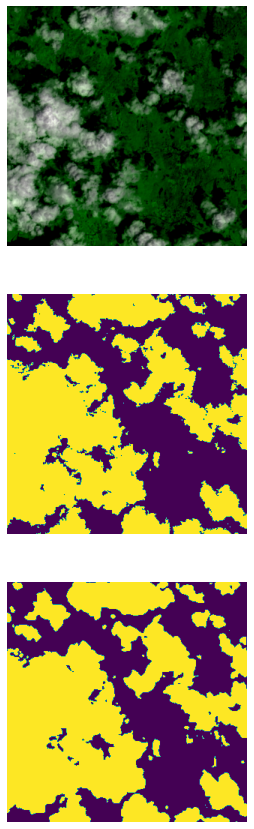

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


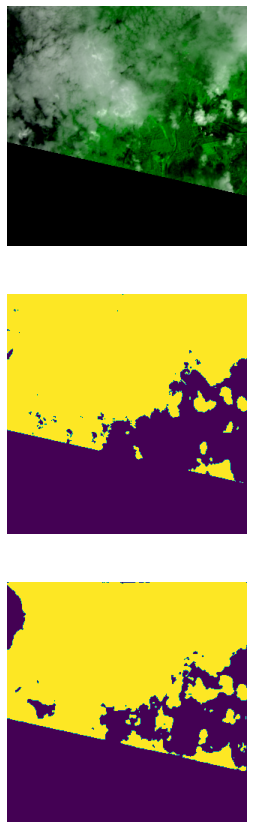

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


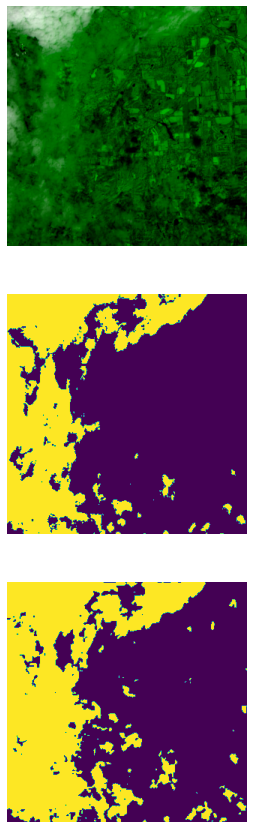

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


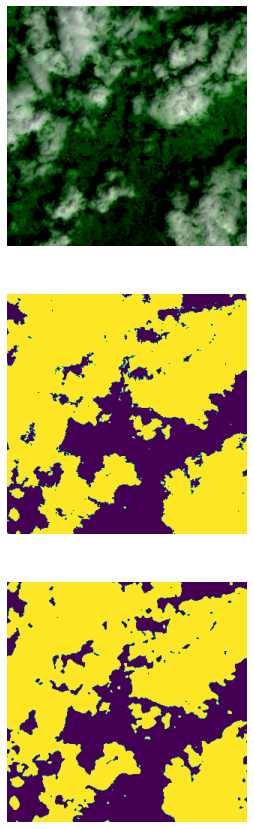

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


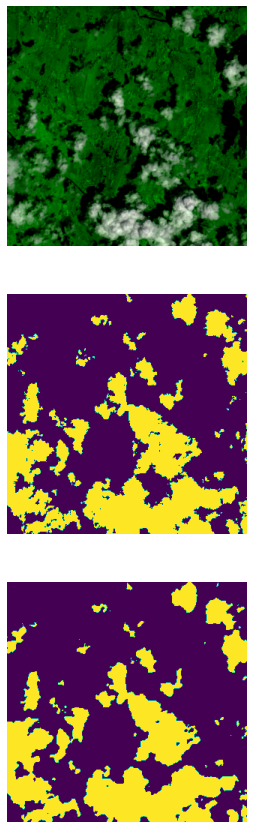

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


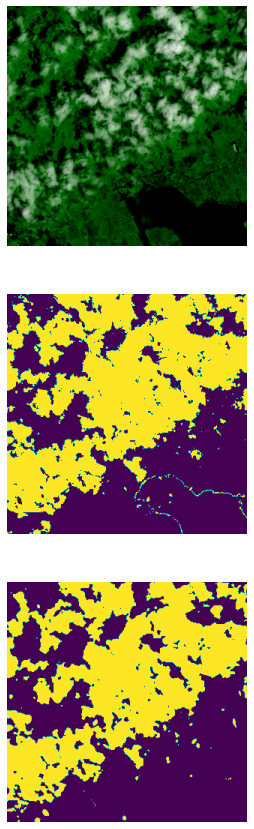

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


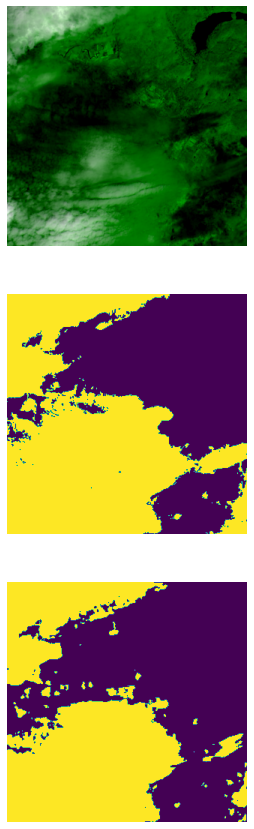

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


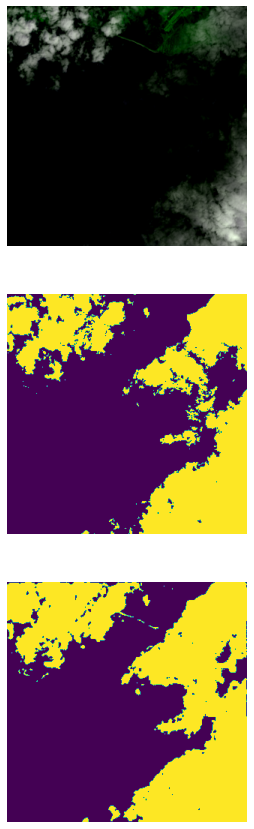

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


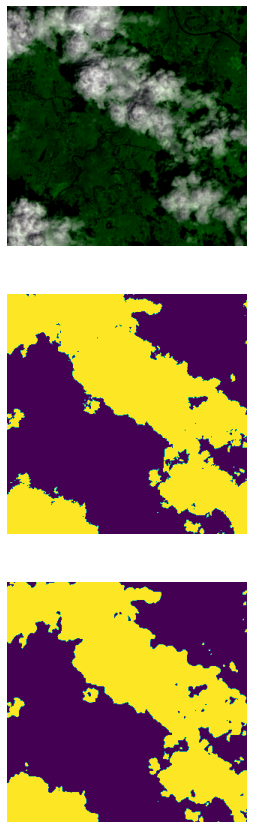

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


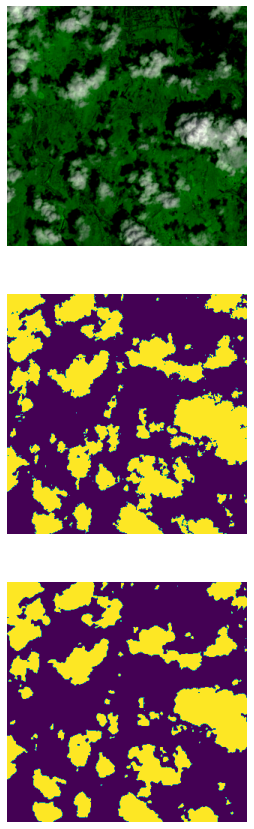

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


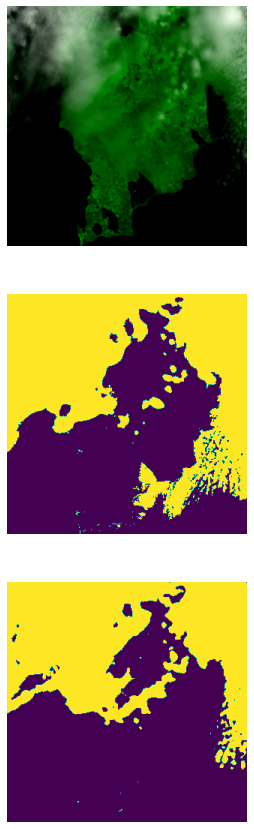

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


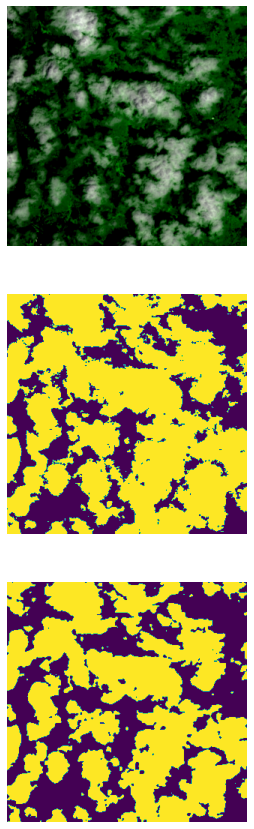

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


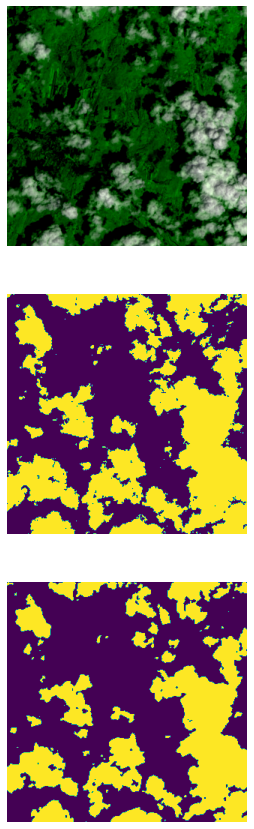

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


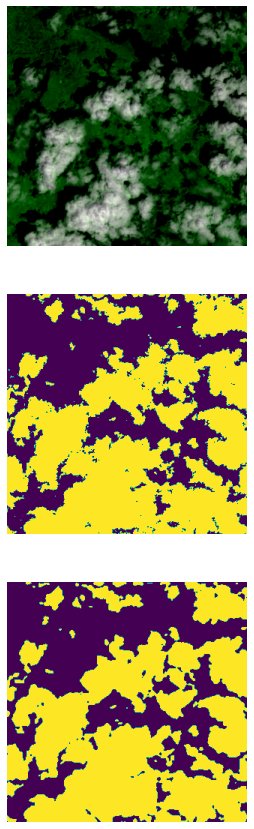

In [21]:
iou = []
bestmodel = model_files[-1]
random_image_files = validation['x'].tolist()[:]#random.choices(validation['x'], k=15)
for f in random_image_files:
    image = np.load(f)
    img3 = image[:,:,[2,3,1]]
    
    f_mask = os.path.join(os.path.dirname(f), os.path.basename(f).replace('_6.npy','_2.npy').replace('x','y'))
    mask = np.load(f_mask)[:,:,1].astype(np.int)
    
    t1 = os.path.basename(bestmodel).replace('.h5','')
    t2 = f'{t1}_{os.path.basename(f_mask)}'
    f_pred = os.path.join(os.path.dirname(f_mask), t2).replace('3. processed_images','4. predictions')
    temp = np.load(f_pred)[0][:,:,1]
    pred = np.zeros(temp.shape)
    pred[temp>=0.6] = 1
    
    iou.append(np.sum(pred==mask)/np.sum(pred>-10000))
    
    fig, (ax1, ax2, ax3) = plt.subplots(3,1, figsize = [5,15])
    ax1.axis('off')
    ax2.axis('off')
    ax3.axis('off')
    ax1.imshow(img3)
    ax2.imshow(mask)   
    ax3.imshow(pred)
    plt.show()

In [16]:
iou

[0.847734375,
 0.73728515625,
 0.488125,
 0.94919921875,
 0.9243359375,
 0.939072265625,
 0.9268359375,
 0.411806640625,
 0.9473046875,
 0.895078125,
 0.925595703125,
 0.915068359375,
 0.95041015625,
 0.6489453125,
 0.947294921875,
 0.940205078125,
 0.927451171875,
 0.865302734375,
 0.9448046875,
 0.9435546875,
 0.8349609375,
 0.905546875,
 0.9359375,
 0.85685546875,
 0.9307421875,
 0.942802734375,
 0.91671875,
 0.952998046875,
 0.85064453125,
 0.9486328125,
 0.929892578125,
 0.760703125,
 0.91095703125,
 0.94037109375,
 0.818798828125,
 0.970966796875,
 0.756298828125,
 0.91814453125,
 0.939189453125,
 0.91626953125,
 0.937392578125,
 0.924931640625,
 0.91259765625,
 0.8840234375,
 0.7476953125,
 0.957158203125,
 0.997080078125,
 0.9437109375,
 0.744716796875,
 0.966416015625,
 0.933984375,
 0.911689453125,
 0.979931640625,
 0.9248828125,
 0.878291015625,
 0.933603515625,
 0.809169921875,
 0.935068359375,
 0.836611328125,
 0.7105859375,
 0.9410546875,
 0.912294921875,
 0.8948828125,
 

In [17]:
np.mean(iou)

0.9023083396849594